##### Copyright 2019 The TensorFlow Authors.

Licensed under the Apache License, Version 2.0 (the "License");

In [1]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Seg2Brain: Segmentation-to-Brain translation with a conditional GAN

## Import TensorFlow and other libraries

In [1]:
import tensorflow as tf

import os
import pathlib
import time
import datetime
import numpy as np
from matplotlib import pyplot as plt
from IPython import display

2025-05-01 12:54:20.011983: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-01 12:54:20.014853: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-01 12:54:22.262189: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-05-01 12:54:22.457649: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1746093262.956830 1986348 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1746093263.83

## Load the dataset



In [2]:
#set the path to the directory where the train, val, and test data exist

PATH = "Data Moj"

In [3]:
sample_image = tf.io.read_file(PATH + '/trainingData-/combined_104.jpg')
sample_image = tf.io.decode_jpeg(sample_image)
print(sample_image.shape)

2025-05-01 13:10:04.358840: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected


(686, 1252, 1)


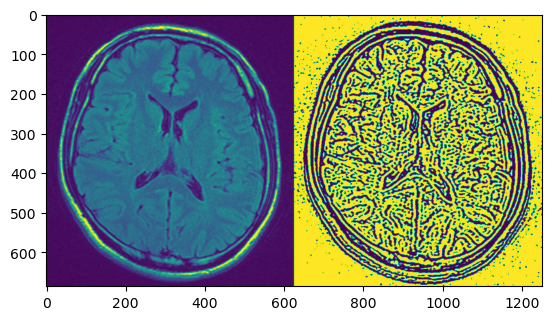

In [4]:
plt.figure()
plt.imshow(sample_image)

You need to separate brain tissue images from the segmentation maps.

Define a function that loads image files and outputs two image tensors:

In [5]:
def load(image_file):
  # Read and decode an image file to a uint8 tensor
  image = tf.io.read_file(image_file)
  image = tf.io.decode_jpeg(image)

  # Split each image tensor into two tensors:
  # - one with a real building facade image
  # - one with an architecture label image
  w = tf.shape(image)[1]
  w = w // 2
  input_image = image[:, w:, :]
  real_image = image[:, :w, :]

  # Convert both images to float32 tensors
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image

Plot a sample of the input (architecture label image) and real (building facade photo) images:

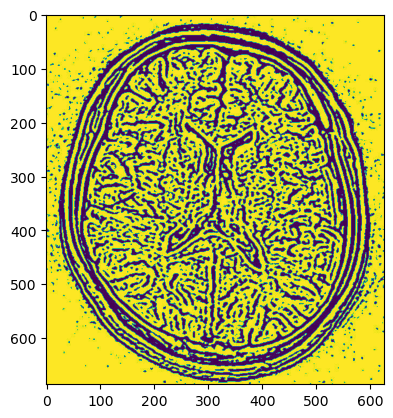

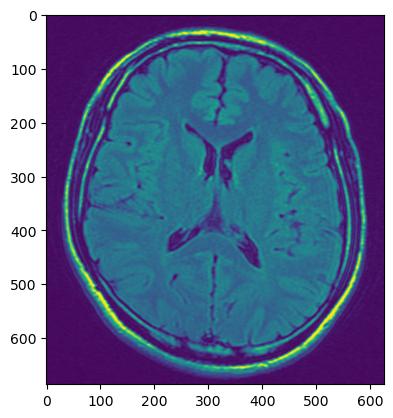

In [6]:
inp, re = load(PATH +'/trainingData-/combined_104.jpg')
# Casting to int for matplotlib to display the images
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

As described in the [pix2pix paper](https://arxiv.org/abs/1611.07004), you need to apply random jittering and mirroring to preprocess the training set.

Define several functions that:

1. Resize each `256 x 256` image to a larger height and width—`286 x 286`.
2. Randomly crop it back to `256 x 256`.
3. Randomly flip the image horizontally i.e., left to right (random mirroring).
4. Normalize the images to the `[-1, 1]` range.

In [7]:
# The training set consist of 1680 images
BUFFER_SIZE = 2000
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [8]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [9]:
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 1])

  return cropped_image[0], cropped_image[1]

In [10]:
# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

You can inspect some of the preprocessed output:

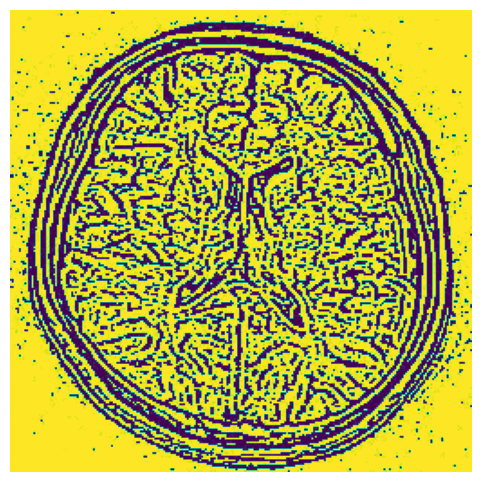

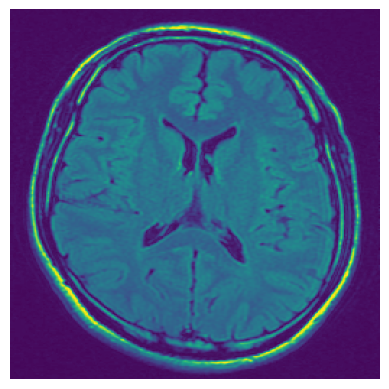

(256, 256, 1) (256, 256, 1)


In [11]:
plt.figure(figsize=(6, 6))
rj_inp, rj_re = resize(inp, re,IMG_HEIGHT, IMG_WIDTH)
plt.imshow(rj_inp / 255.0)
plt.axis('off')
plt.show()
plt.imshow(rj_re / 255.0)
plt.axis('off')
plt.show()
print(np.shape(rj_inp), np.shape(rj_re))

Having checked that the loading and preprocessing works, let's define a couple of helper functions that load and preprocess the training and test sets:

In [12]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [13]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

## Build an input pipeline with `tf.data`

In [14]:
#trainset contains 1643 samples
train_dataset = tf.data.Dataset.list_files(PATH+'/trainingData-/*.jpg')
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [15]:
## here we build the test (480 samples) and validation (240 samples) sets.
#Please note that in the data folder, we have about 600 Totally_Unseen dataset which I beleive we can use for creating totally non-existing cases.
#my idea is that we can combine the white matter mask from healthy cases and lesion masks from the abnormal cases to create a new mask and create new inputs.
# By combining the masks from healthy and nonhealthy cases, we create a new subject and let the model to synthesize a new brain for us.
#Using the synthetic images you can train a new classifier or mix them with real images and retrain the classifier.
try:
 val_dataset = tf.data.Dataset.list_files(PATH+'/validation/*.jpg')
except tf.errors.InvalidArgumentError:
 val_dataset = tf.data.Dataset.list_files(PATH+'/validation/*.jpg')
val_dataset = val_dataset.map(load_image_test)
val_dataset = val_dataset.batch(BATCH_SIZE)

try:
 test_dataset = tf.data.Dataset.list_files(PATH+'/testingData-/*.jpg')
except tf.errors.InvalidArgumentError:
 test_dataset = tf.data.Dataset.list_files(PATH+'/testingData-/*jpg')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

Define the downsampler (encoder):

## Build the generator

The generator of your pix2pix cGAN is a _modified_ [U-Net](https://arxiv.org/abs/1505.04597). A U-Net consists of an encoder (downsampler) and decoder (upsampler). (You can find out more about it in the [Image segmentation](../images/segmentation.ipynb) tutorial and on the [U-Net project website](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/).)

- Each block in the encoder is: Convolution -> Batch normalization -> Leaky ReLU
- Each block in the decoder is: Transposed convolution -> Batch normalization -> Dropout (applied to the first 3 blocks) -> ReLU
- There are skip connections between the encoder and decoder (as in the U-Net).

In [16]:
OUTPUT_CHANNELS = 1

In [17]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

Define the upsampler (decoder):

In [18]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

Define the generator with the downsampler and the upsampler:

In [19]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 1])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)
    downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

Visualize the generator model architecture:

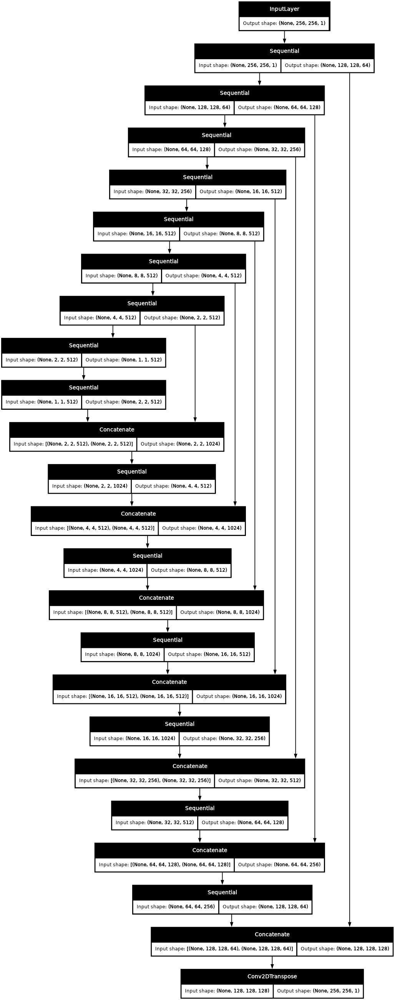

In [20]:
from tensorflow.keras.utils import plot_model

generator = Generator()
plot_model(generator, to_file='generatorrr_model.png', show_shapes=True, dpi=64)


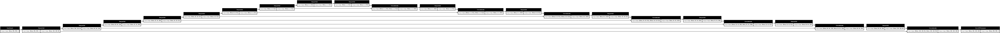

In [21]:
from tensorflow.keras.utils import plot_model
from keras.models import Model  # or your model class
import os

# Assuming your model is called generator
generator = Generator()

# Plot horizontally
plot_model(generator,
           to_file='generator_horizontal.png',
           show_shapes=True,
           dpi=96,
           rankdir='LR')  # Set direction to Left to Right


Test the generator:

### Define the generator loss

GANs learn a loss that adapts to the data, while cGANs learn a structured loss that penalizes a possible structure that differs from the network output and the target image, as described in the [pix2pix paper](https://arxiv.org/abs/1611.07004).

- The generator loss is a sigmoid cross-entropy loss of the generated images and an **array of ones**.
- The pix2pix paper also mentions the L1 loss, which is a MAE (mean absolute error) between the generated image and the target image.
- This allows the generated image to become structurally similar to the target image.
- The formula to calculate the total generator loss is `gan_loss + LAMBDA * l1_loss`, where `LAMBDA = 100`. This value was decided by the authors of the paper.

In [22]:
LAMBDA = 100

In [23]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [24]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

The training procedure for the generator is as follows:

![Generator Update Image](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/gen.png?raw=1)


## Build the discriminator

The discriminator in the pix2pix cGAN is a convolutional PatchGAN classifier—it tries to classify if each image _patch_ is real or not real, as described in the [pix2pix paper](https://arxiv.org/abs/1611.07004).

- Each block in the discriminator is: Convolution -> Batch normalization -> Leaky ReLU.
- The shape of the output after the last layer is `(batch_size, 30, 30, 1)`.
- Each `30 x 30` image patch of the output classifies a `70 x 70` portion of the input image.
- The discriminator receives 2 inputs:
    - The input image and the target image, which it should classify as real.
    - The input image and the generated image (the output of the generator), which it should classify as fake.
    - Use `tf.concat([inp, tar], axis=-1)` to concatenate these 2 inputs together.

Let's define the discriminator:

In [25]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 1], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 1], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

Visualize the discriminator model architecture:

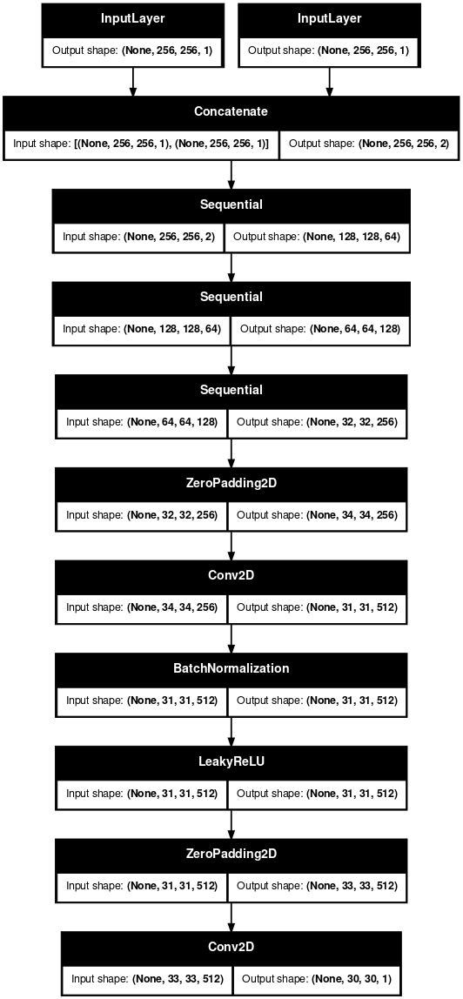

In [26]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

Test the discriminator:

### Define the discriminator loss

- The `discriminator_loss` function takes 2 inputs: **real images** and **generated images**.
- `real_loss` is a sigmoid cross-entropy loss of the **real images** and an **array of ones(since these are the real images)**.
- `generated_loss` is a sigmoid cross-entropy loss of the **generated images** and an **array of zeros (since these are the fake images)**.
- The `total_loss` is the sum of `real_loss` and `generated_loss`.

In [27]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss
  print(total_disc_loss)

  return total_disc_loss

The training procedure for the discriminator is shown below.

To learn more about the architecture and the hyperparameters you can refer to the [pix2pix paper](https://arxiv.org/abs/1611.07004).

![Discriminator Update Image](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/dis.png?raw=1)


## Define the optimizers and a checkpoint-saver


In [28]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [29]:
#make sure to provide a directory so save your checkpoints. You need them to restore your models. Alternatively, you can save your model as .h5 somewhere on your disk space.
checkpoint_dir = './partallneg_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Generate images

Write a function to plot some images during training.

- Pass images from the test set to the generator.
- The generator will then translate the input image into the output.
- The last step is to plot the predictions and _voila_!

Note: The `training=True` is intentional here since you want the batch statistics, while running the model on the test dataset. If you use `training=False`, you get the accumulated statistics learned from the training dataset (which you don't want).

In [30]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 5 + 5)
    plt.axis('off')
  plt.show()

Test the function:

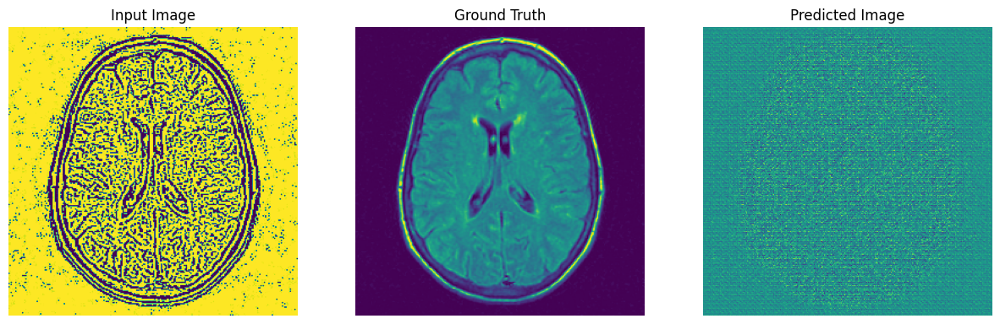

2025-03-19 00:29:24.810654: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [31]:
 for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

## Training

- For each example input generates an output.
- The discriminator receives the `input_image` and the generated image as the first input. The second input is the `input_image` and the `target_image`.
- Next, calculate the generator and the discriminator loss.
- Then, calculate the gradients of loss with respect to both the generator and the discriminator variables(inputs) and apply those to the optimizer.
- Finally, log the losses to TensorBoard.

In [32]:
log_dir="logsallneg/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [33]:
@tf.function
def train_step(input_image, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)
    
  return(gen_gan_loss, disc_loss)


    

The actual training loop. Since this tutorial can run of more than one dataset, and the datasets vary greatly in size the training loop is setup to work in steps instead of epochs.

- Iterates over the number of steps.
- Every 10 steps print a dot (`.`).
- Every 1k steps: clear the display and run `generate_images` to show the progress.
- Every 5k steps: save a checkpoint.

In [34]:
 
generator_gan_losses = []

discriminator_losses = []


def fit(train_ds, test_ds, steps):
  example_input, example_target = next(iter(test_ds.take(1)))
  start = time.time()

  for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
    if (step) % 1000 == 0:
      display.clear_output(wait=True)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

      start = time.time()

      generate_images(generator, example_input, example_target)
      print(f"Step: {step//1000}k")

    gen_gan_loss, disc_loss = train_step(input_image, target, step)
    generator_gan_losses.append(gen_gan_loss.numpy())  # Storing discriminator loss
    discriminator_losses.append(disc_loss.numpy())  # Storing discriminator loss

    
    
    
    if (step+1) % 10 == 0:
      print(f'Step {step+1}: Gen Gan Loss = {gen_gan_loss.numpy()}, Discriminator Loss = {disc_loss.numpy()}')

    if (step + 1) % 20000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)    
    

This training loop saves logs that you can view in TensorBoard to monitor the training progress.

If you work on a local machine, you would launch a separate TensorBoard process. When working in a notebook, launch the viewer before starting the training to monitor with TensorBoard.

Launch the TensorBoard viewer (Sorry, this doesn't
display on tensorflow.org):

In [35]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

You can view the [results of a previous run](https://tensorboard.dev/experiment/lZ0C6FONROaUMfjYkVyJqw) of this notebook on [TensorBoard.dev](https://tensorboard.dev/).

Finally, run the training loop:

Time taken for 1000 steps: 474.89 sec



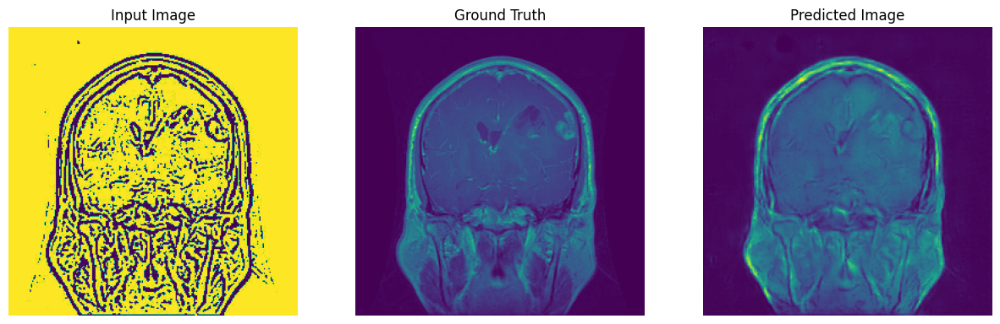

Step: 99k
Step 99010: Gen Gan Loss = 1.959767460823059, Discriminator Loss = 1.181027889251709
Step 99020: Gen Gan Loss = 0.960273802280426, Discriminator Loss = 0.8802577257156372
Step 99030: Gen Gan Loss = 1.2011321783065796, Discriminator Loss = 1.1575701236724854
Step 99040: Gen Gan Loss = 1.1264750957489014, Discriminator Loss = 0.9400382041931152
Step 99050: Gen Gan Loss = 0.9600805640220642, Discriminator Loss = 0.7333452701568604
Step 99060: Gen Gan Loss = 0.9163427948951721, Discriminator Loss = 1.0471374988555908
Step 99070: Gen Gan Loss = 0.8266552090644836, Discriminator Loss = 0.9773570895195007
Step 99080: Gen Gan Loss = 0.7735004425048828, Discriminator Loss = 0.8424406051635742
Step 99090: Gen Gan Loss = 0.19810183346271515, Discriminator Loss = 2.223098039627075
Step 99100: Gen Gan Loss = 0.835186243057251, Discriminator Loss = 0.7661008238792419
Step 99110: Gen Gan Loss = 2.1311752796173096, Discriminator Loss = 0.9642912745475769
Step 99120: Gen Gan Loss = 0.49137920

Step 99960: Gen Gan Loss = 0.6206274032592773, Discriminator Loss = 1.3163083791732788
Step 99970: Gen Gan Loss = 1.9543695449829102, Discriminator Loss = 0.281294047832489
Step 99980: Gen Gan Loss = 1.0827714204788208, Discriminator Loss = 0.6860686540603638
Step 99990: Gen Gan Loss = 1.8694789409637451, Discriminator Loss = 1.2371371984481812
Step 100000: Gen Gan Loss = 2.3522884845733643, Discriminator Loss = 0.638965368270874


2025-03-19 12:59:38.037696: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [36]:
#steps= number of epochs x total number of training cases ==> for example 50 x 1643 = 82150 >> this means you need to set your steps to 82150 if you want to run your model for 50 epochs.
fit(train_dataset, val_dataset, steps=100000) ## change the number of steps to 82150 if you want 50 epochs.

Interpreting the logs is more subtle when training a GAN (or a cGAN like pix2pix) compared to a simple classification or regression model. Things to look for:

- Check that neither the generator nor the discriminator model has "won". If either the `gen_gan_loss` or the `disc_loss` gets very low, it's an indicator that this model is dominating the other, and you are not successfully training the combined model.
- The value `log(2) = 0.69` is a good reference point for these losses, as it indicates a perplexity of 2 - the discriminator is, on average, equally uncertain about the two options.
- For the `disc_loss`, a value below `0.69` means the discriminator is doing better than random on the combined set of real and generated images.
- For the `gen_gan_loss`, a value below `0.69` means the generator is doing better than random at fooling the discriminator.
- As training progresses, the `gen_l1_loss` should go down.

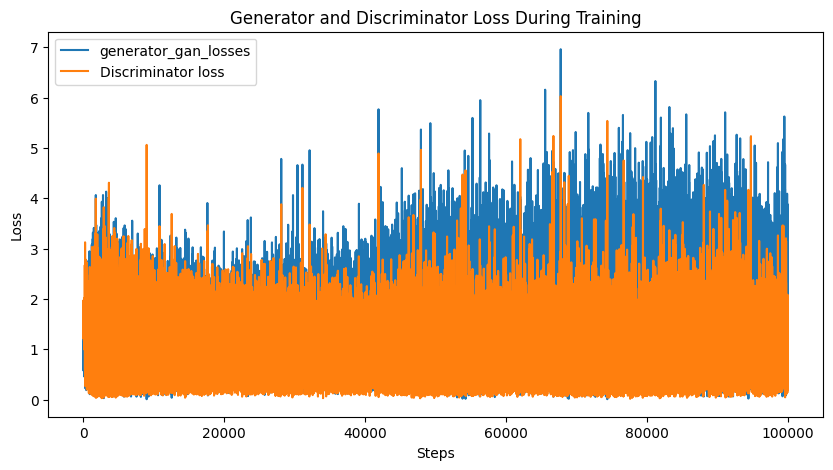

In [37]:
import matplotlib.pyplot as plt

# Plotting the generator and discriminator loss
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(generator_gan_losses, label="generator_gan_losses")
plt.plot(discriminator_losses, label="Discriminator loss")
plt.xlabel("Steps")
plt.ylabel("Loss")
plt.legend()
plt.show()


## Restore the latest checkpoint and test the network

In [38]:
!ls {checkpoint_dir}

checkpoint		    ckpt-5.index
ckpt-1.data-00000-of-00001  ckpt-6.data-00000-of-00001
ckpt-1.index		    ckpt-6.index
ckpt-2.data-00000-of-00001  ckpt-7.data-00000-of-00001
ckpt-2.index		    ckpt-7.index
ckpt-3.data-00000-of-00001  ckpt-8.data-00000-of-00001
ckpt-3.index		    ckpt-8.index
ckpt-4.data-00000-of-00001  ckpt-9.data-00000-of-00001
ckpt-4.index		    ckpt-9.index
ckpt-5.data-00000-of-00001


In [39]:
# Restoring the latest checkpoint in checkpoint_dir
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [40]:
 import tensorflow as tf

# Assume the models are defined as functions or imported from your model script
generator = Generator()
discriminator = Discriminator()

# Create a checkpoint instance
checkpoint_dir = '/partallneg_checkpoints'
checkpoint = tf.train.Checkpoint(generator=generator, discriminator=discriminator)

# Restore the latest checkpoint
latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
if latest_checkpoint:
    checkpoint.restore(latest_checkpoint)
    print("Checkpoint restored successfully from {}".format(latest_checkpoint))
else:
    print("No checkpoint found at {}".format(checkpoint_dir))

No checkpoint found at /partallneg_checkpoints


In [41]:
 # Save the entire model to a file
generator.save('generatorallneg_model.h5')
discriminator.save('discriminatorallneg_model.h5')
print("Models saved to disk.")

# Later, load the models back
#loaded_generator = tf.keras.models.load_model('generator_model.h5')
#loaded_discriminator = tf.keras.models.load_model('discriminator_model.h5')
#print("Models loaded from disk.")


Models saved to disk.


## Generate some images using the test set

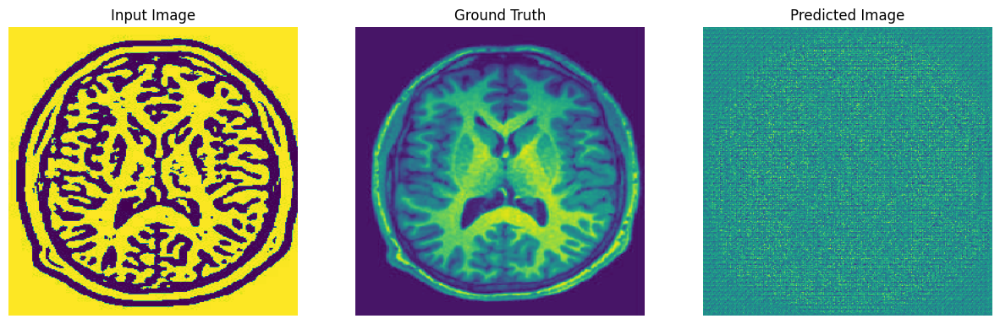

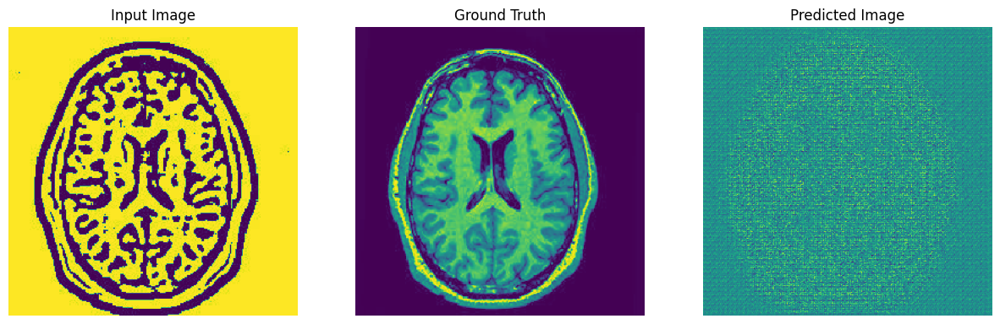

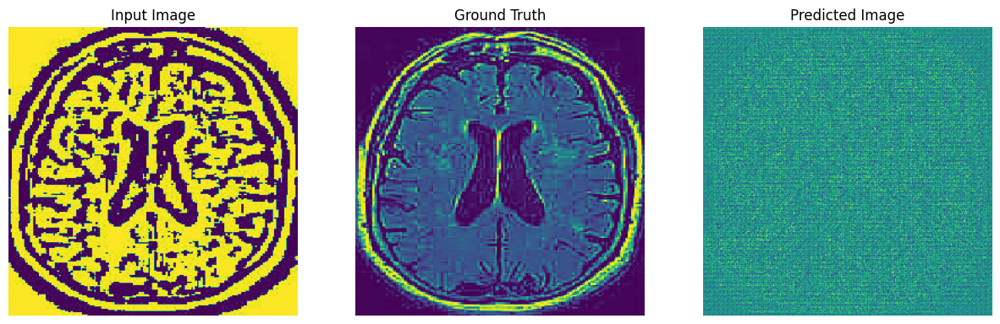

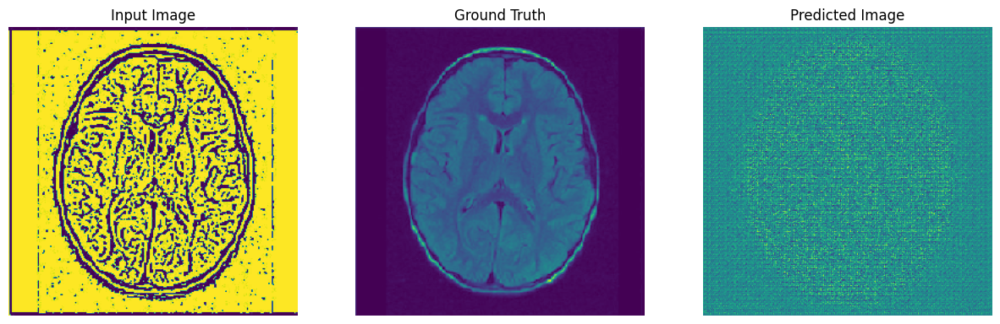

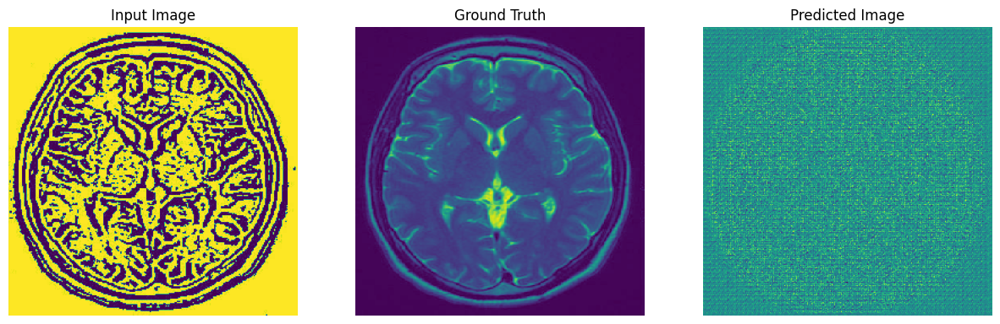

...

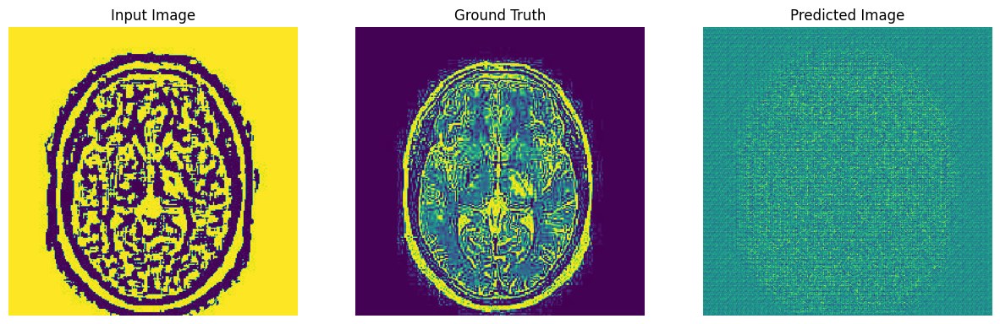

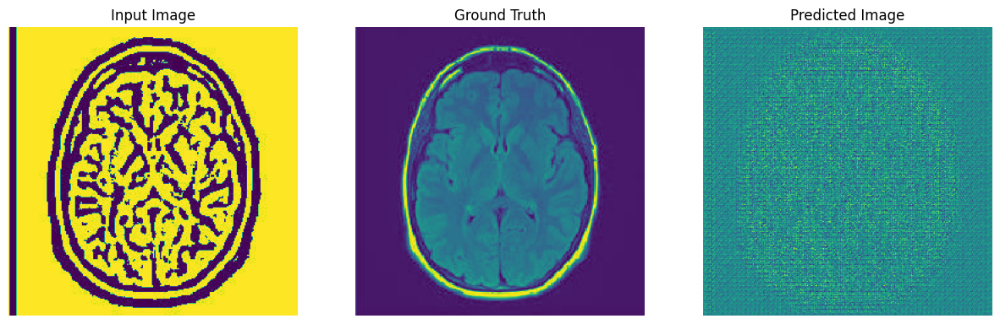

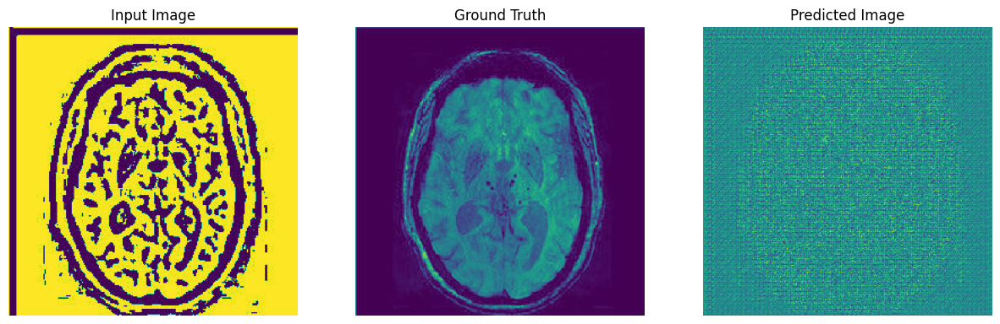

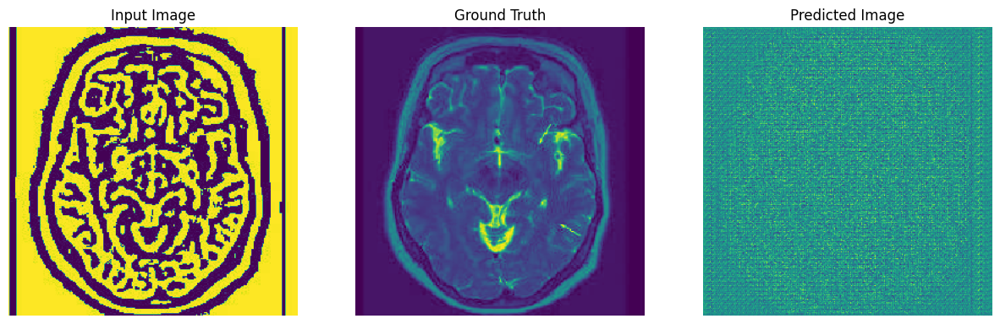

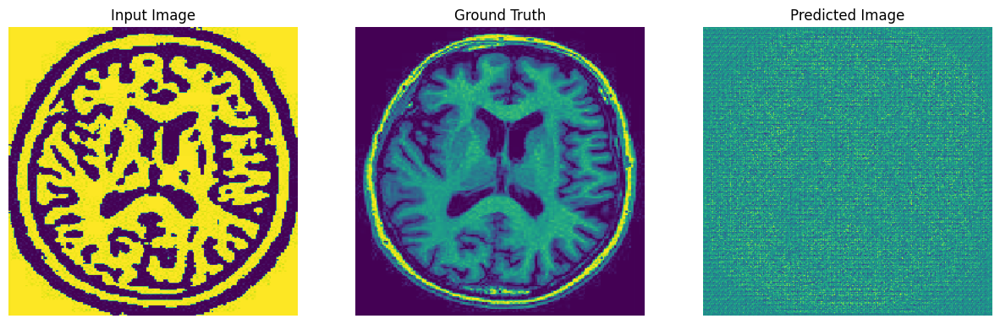

In [ ]:
# Run the trained model on a few examples from the test set.
#Also change the number_of_samples to 480 if you want to test all cases in the test folder.
#You must modify the generate_images function to save your predictions as jpg files.
number_of_samples=1000
for inp, tar in test_dataset.take(number_of_samples):
  generate_images(generator, inp, tar)

In [ ]:
import os
import tensorflow as tf
import matplotlib.pyplot as plt

# Directory to save generated images
output_directory = "partallneg50imagesss_generated"
os.makedirs(output_directory, exist_ok=True)  # Ensure the directory exists

def generate_and_save_images(model, test_input, tar, idx):
    prediction = model(test_input, training=True)
    # Normalize the pixel values to [0, 255]
    prediction = (prediction[0] * 0.5 + 0.5) * 255.0
    prediction = tf.cast(prediction, tf.uint8)

    # Save the generated image as JPEG
    save_path = os.path.join(output_directory, f"generated_image_{idx + 1}.jpg")
    encoded_image = tf.image.encode_jpeg(prediction)
    tf.io.write_file(save_path, encoded_image)
    print(f"Saved: {save_path}")

    # Optional: Display images
    plt.figure(figsize=(15, 15))
    # Cast prediction to float32 for consistent dtype operations
    prediction_float = tf.cast(prediction, tf.float32)
    display_list = [test_input[0] * 0.5 + 0.5, tar[0] * 0.5 + 0.5, prediction_float / 255.0]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        plt.title(title[i])
        plt.imshow(display_list[i], cmap='gray')
        plt.axis('off')
    plt.show()

# Running the modified function on test data
number_of_samples = 1000  # Number of samples to generate and save
for idx, (inp, tar) in enumerate(test_dataset.take(number_of_samples)):
    generate_and_save_images(generator, inp, tar, idx)


In [ ]:
 import os
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

# Directory to save generated images
output_directory = "partallneg50imagesssallmerged_generated"
os.makedirs(output_directory, exist_ok=True)  # Ensure the directory exists

def generate_and_save_images(model, test_input, tar, idx):
    prediction = model(test_input, training=True)
    
    # Normalize pixel values to [0, 255] and convert to numpy arrays
    input_image = np.array((test_input[0].numpy() * 0.5 + 0.5) * 255.0, dtype=np.uint8)
    ground_truth = np.array((tar[0].numpy() * 0.5 + 0.5) * 255.0, dtype=np.uint8)
    prediction = np.array((prediction[0].numpy() * 0.5 + 0.5) * 255.0, dtype=np.uint8)
    
    # Ensure images are 2D grayscale
    def ensure_grayscale(image):
        if image.ndim == 3:
            return image[:, :, 0]  # Take the first channel if it has three
        return image
    
    input_image = ensure_grayscale(input_image)
    ground_truth = ensure_grayscale(ground_truth)
    prediction = ensure_grayscale(prediction)
    
    # Ensure all images have the same height and width
    height, width = input_image.shape[:2]
    ground_truth = np.array(Image.fromarray(ground_truth).resize((width, height)))
    prediction = np.array(Image.fromarray(prediction).resize((width, height)))
    
    # Stack images horizontally
    combined_image = np.hstack([input_image, ground_truth, prediction])
    
    # Save the combined image
    save_path = os.path.join(output_directory, f"comparison_{idx}.jpg")
    Image.fromarray(combined_image).convert("L").save(save_path)  # Save as grayscale
    print(f"Saved: {save_path}")

# Running the modified function on test data
number_of_samples = 1000  # Number of samples to generate and save
for idx, (inp, tar) in enumerate(test_dataset.take(number_of_samples), start=1):
    generate_and_save_images(generator, inp, tar, idx)
